# Linear Regression

# Step 1

In [7]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
n = int(input())  # user input (no. of datapoints)

100


In [3]:
def chooseParam():
    return np.random.uniform(-2, 2, 1), np.random.uniform(-2, 2, 1)  # returns [w], [b]

In [4]:
def generateNoisyLinearData(n, xLo, xHi, w, b, noiseType, sigma):
    X = np.random.uniform(xLo, xHi, n)
    if noiseType == "gaussian":
        noise = np.random.normal(0, sigma, n) # Gaussian distribution
    else:
        noise = np.random.uniform(-1, 1, n) # Uniform distribution
    y = w * X + b + noise
    return X, y

In [5]:
def plotLinearData(X, y):
    plt.scatter(X, y)
    plt.xlabel("X - Input")
    plt.ylabel("y - Label")
    plt.show()

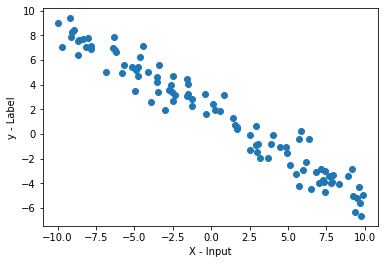

In [6]:
wb  = chooseParam()
X, y = generateNoisyLinearData(n, -10, 10, wb[0], wb[1], "gaussian", 1)
plotLinearData(X, y)

# Step 2

In [7]:
# func computes loss
def loss(w, b, x, ytrue, lossType):
    y_pred = w * x + b
    if lossType == 1:  # squared
        loss = np.square(y_pred - ytrue)
    elif lossType == 0:  # absolute
        loss = np.abs(y_pred - ytrue)
    return loss


# computes cost
def cost(w, b, x, y, l, n):
    avgCost = 0
    for val in range(0, n):
        avgCost  = avgCost + loss(w, b, x[val], y[val], l)
    return avgCost/n

In [8]:
def costPlot(X, y):
    b = chooseParam()[1]
    w = []
    c = []
    for i in range(n):
        wb = chooseParam()
        w.append(wb[0])
        c.append(cost(w[i], b, X, y, 1, n))
    plt.scatter(np.array(w), np.array(c))
    plt.xlabel("Slope")
    plt.ylabel("Cost")
    plt.show()
    return np.array(w), np.array(c)

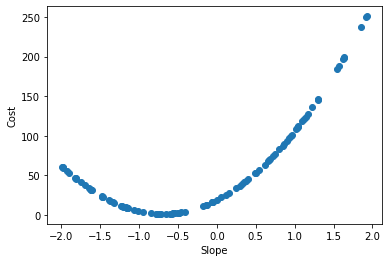

In [9]:
# graph of Cost with respect to changing values of w (Slope)
w, c = costPlot(X, y)

According to the observation from above dataset, the value of cost will be minimum when the average distance between a line and the datapoints is minimum.

The line is represented by the equation y = wx+b, and we are providing random w(Slope) values to our cost function to compute Ypred, so the value of w(slope) determines the value of cost function, which we can also observe in the above graph. Because even if we make b=0, and keep on changing the value of w(slope) we can observe a curve shaped graph.

Some of the other examples are as follows

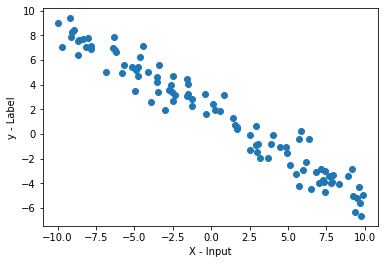

In [10]:
wb  = chooseParam()
X1, y1 = generateNoisyLinearData(50, 1, 100, wb[0], wb[1], "gaussian", 1)
plotLinearData(X, y)

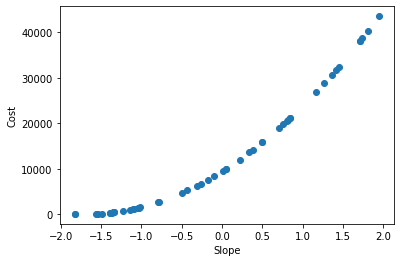

In [11]:
b  = chooseParam()
w = []
c = []
for i in range(50):
    w.append(chooseParam()[0])    # random slope values
    c.append(cost(w[i], b[1], X1, y1, 1, 50))
plt.scatter(np.array(w), np.array(c))
plt.xlabel("Slope")
plt.ylabel("Cost")
plt.show()

# Step 3

In [12]:
# 3D plot between choosen values of w, b and estimated cost

In [13]:
from mpl_toolkits.mplot3d import Axes3D

In [14]:
# b and w values for showing 3D graph
b = np.linspace(-3, 1, n)
w = np.linspace(-2, 2, n)

In [15]:
W, B = np.meshgrid(w, b)

In [16]:
c = []
for i, j in zip(W, B):
    c.append(cost(i, j, X, y, 1, n))
c = np.array(c)

In [17]:
W, B, c

(array([[-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ],
        [-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ],
        [-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ],
        ...,
        [-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ],
        [-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ],
        [-2.        , -1.95959596, -1.91919192, ...,  1.91919192,
          1.95959596,  2.        ]]),
 array([[-3.        , -3.        , -3.        , ..., -3.        ,
         -3.        , -3.        ],
        [-2.95959596, -2.95959596, -2.95959596, ..., -2.95959596,
         -2.95959596, -2.95959596],
        [-2.91919192, -2.91919192, -2.91919192, ..., -2.91919192,
         -2.91919192, -2.91919192],
        ...,
        [ 0.91919192,  0.91919192,  0.91919192, ...,  

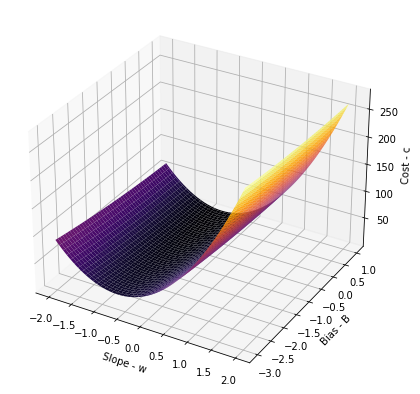

In [18]:
fig = plt.figure(figsize=[10,7])
axes = fig.add_subplot(111, projection='3d')
axes.plot_surface(W, B, c, cmap='inferno')
axes.set_xlabel('Slope - w')
axes.set_ylabel('Bias - B')
axes.set_zlabel('Cost - c')
plt.show()

In [19]:
estimated_w = 0.25
extimated_b = 1.25

Countour Plot

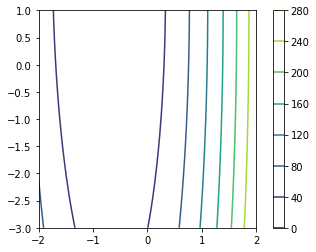

In [20]:
plt.contour(W, B, c)
plt.axis('scaled')
plt.colorbar()
plt.show()

# Step 4

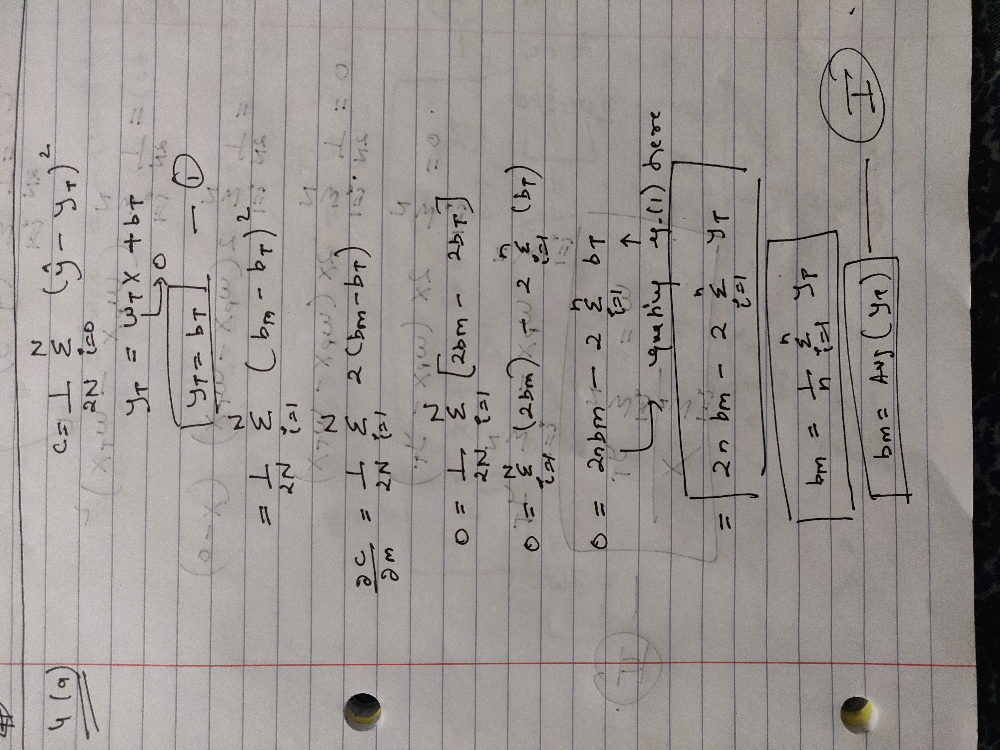

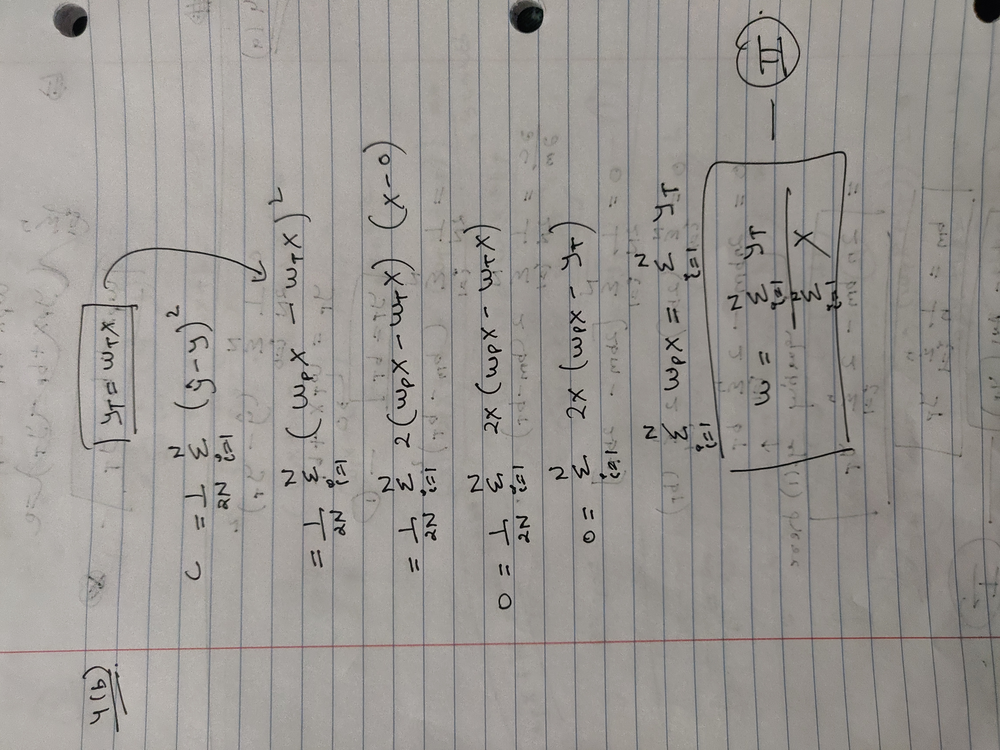

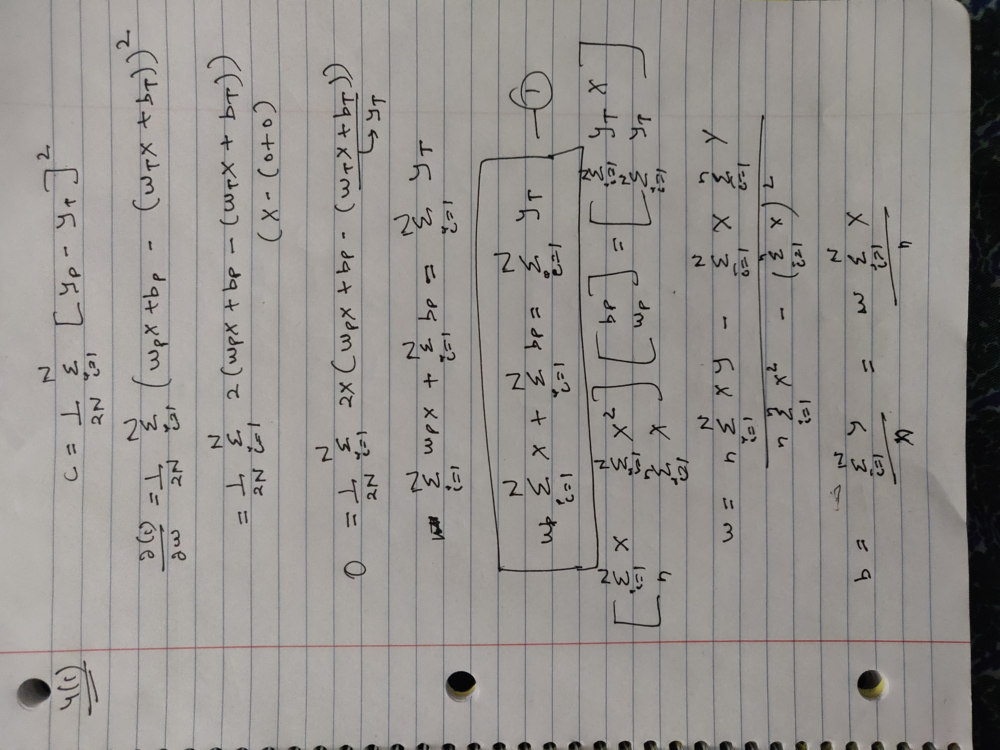

In [21]:
# python functions for step 4
def dC_dw(w,b,X,Y):
    return ( (X*Y - Y.mean()*X).sum() ) / ( np.square(X) - X.mean()*X ).sum()

def dC_db(w,b,X,Y):
    return Y.mean() - (computeDeriv_dC_dw(w,b,X,Y)*X.mean())

In [22]:
slope = -0.1625128191857218 
intercept = 1.2414395448175373

# Step 5 -- Partial derivative of cost func w.r.t w and b

                                            Partial derivative with respect to m

$$ f(m,b) = 1/n\sum_{i=1}^n(yPred - yTrue)^2  ... (1) $$         

where yTrue = mx + b      -- using this in eqn.(1)

$$ f(m,b) = 1/n\sum_{i=1}^n(yi - (mxi + b))^2 $$

$$ d(f)/d(m) = 1/n\sum_{i=1}^n2(yi - (mxi + b)) (0-(xi+0)) $$

$$ d(f)/d(m) = 1/n\sum_{i=1}^n-2xi(yi - (mxi + b)) $$

                                            Partial derivative with respect to b

$$ f(m,b) = 1/n\sum_{i=1}^n(yi - (mxi + b))^2 $$

$$ d(f)/d(b) = 1/n\sum_{i=1}^n2(yi - (mxi + b)) (0-(0+1)) $$

$$ d(f)/d(b) = 1/n\sum_{i=1}^n-2(yi - (mxi + b)) $$

In [23]:
def computeDeriv_dC_dw(w,b,X,Y):
    Y_pred = np.dot(w, X) + b
    d_w = (-2/n) * sum(X * (y - Y_pred))
    return d_w

In [24]:
computeDeriv_dC_dw(w, b, X, y)

125.78403960900674

In [25]:
def computeDeriv_dC_db(w,b,X,Y):
    Y_pred = np.dot(w, X) + b
    d_c = (-2/n) * sum(Y - Y_pred)
    return d_c

In [26]:
computeDeriv_dC_db(w, b, X, y)

217.96678330630792

In [27]:
slope, intercept

(-0.1625128191857218, 1.2414395448175373)

When i plug in the values of Wopt and bopt, i get the following values

In [28]:
computeDeriv_dC_dw(slope, intercept, X, y)

38.87272556813178

In [29]:
computeDeriv_dC_db(slope, intercept, X, y)

-0.7232941357676641

# Step 6

In [30]:
def updateParams(w,b,X,y,alpha,epochs):
    w_set = []
    b_set = []
    for i in range(epochs):
        w = w - alpha * computeDeriv_dC_dw(w, b, X, y)
        b = b - alpha * computeDeriv_dC_db(w, b, X, y)
        w_set.append(w)
        b_set.append(b)
    return w, b, w_set, b_set

In [31]:
pred_w, pred_b, w_set, b_set = updateParams(w[0],b[0],X,y,0.01,200)

In [32]:
pred_w, pred_b

(-0.7039597248319974, 1.6988411751740882)

Text(0, 0.5, 'Y - inputs')

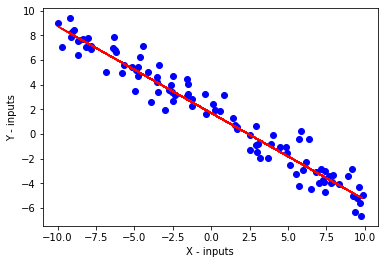

In [33]:
plt.scatter(X, y, color = 'blue')
plt.plot(X, pred_w*X+pred_b, 'r')
plt.xlabel("X - inputs")
plt.ylabel("Y - inputs")

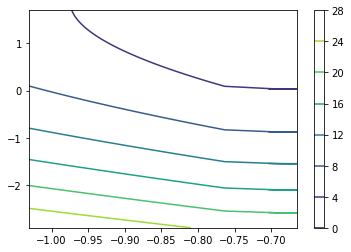

In [34]:
w_mesh, b_mesh = np.meshgrid(w_set, b_set)
c = []
for i, j in zip(w_mesh, b_mesh):
    c.append(cost(i, j, X, y, 1, n))
c = np.array(c)

plt.contour(w_mesh, b_mesh, c)
plt.colorbar()
plt.show()

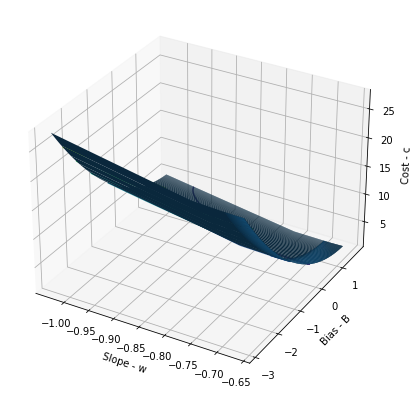

In [35]:
fig = plt.figure(figsize=[10,7])
axes = fig.add_subplot(projection='3d')
axes.plot_surface(w_mesh, b_mesh, c)
plt.contour(w_mesh, b_mesh, c)
axes.set_xlabel('Slope - w')
axes.set_ylabel('Bias - B')
axes.set_zlabel('Cost - c')
plt.show()

Text(0, 0.5, 'Y - inputs')

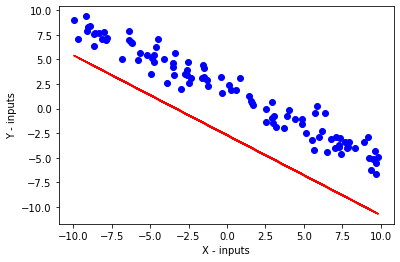

In [36]:
# changing learning rate
import matplotlib.pyplot as plt1
pred_w, pred_b, _, _ = updateParams(w[0],b[0],X,y,0.0001,300)
plt1.scatter(X, y, color = 'blue')
plt1.plot(X, pred_w*X+pred_b, 'r')
plt1.xlabel("X - inputs")
plt1.ylabel("Y - inputs")

As we can observe, when learning rate is reduced and epochs are kept constant, it will take more iterations to reach global minima

In [37]:
error_in_iteration = []
for val in range(0, 200):
    error_in_iteration.append(cost(w_set[val], b_set[val], X, y, 1, n))

Text(0, 0.5, 'Error in each iteration')

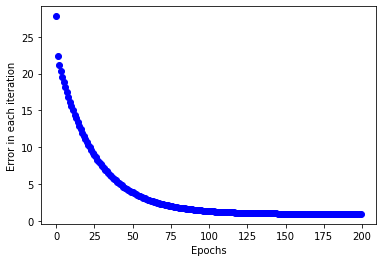

In [38]:
plt.scatter(list(range(200)), error_in_iteration, color = 'blue')
plt.xlabel("Epochs")
plt.ylabel("Error in each iteration")

Text(0, 0.5, 'w value in iteration')

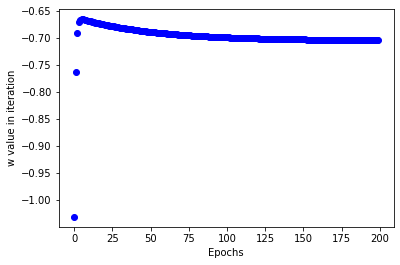

In [39]:
#change in w wrt to iterations
plt.scatter(list(range(200)), w_set, color = 'blue')
plt.xlabel("Epochs")
plt.ylabel("w value in iteration")

Text(0, 0.5, 'b value in iteration')

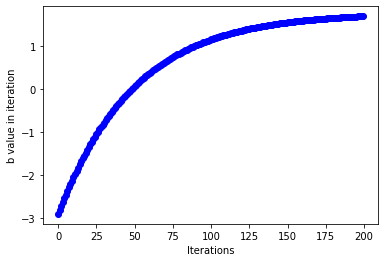

In [40]:
#change in b wrt to iterations
plt.scatter(list(range(200)), b_set, color = 'blue')
plt.xlabel("Iterations")
plt.ylabel("b value in iteration")

# Step 7

In [41]:
# adding regularization

$$ d(f)/d(m) = 1/n\sum_{i=1}^n-2xi(yi - (mxi + b)) + 2λm $$

$$ d(f)/d(b) = 1/n\sum_{i=1}^n-2(yi - (mxi + b)) + 2λb $$

In [42]:
# ridge regression
def updateParams(w,b,X,y,alpha,epochs, lamda):
    for i in range(epochs):
        w = w - alpha * (computeDeriv_dC_dw(w, b, X, y) + 2 * lamda * w)
        b = b - alpha * (computeDeriv_dC_db(w, b, X, y) + 2 * lamda * b)
    return w, b

In [43]:
hp_w, hp_b = updateParams(w[0],b[0],X,y,0.01,200, .05)

In [44]:
hp_w, hp_b

(-0.7023604672410163, 1.6302978462875075)

In [45]:
# after hyperparameter tuining

Text(0, 0.5, 'Y - inputs')

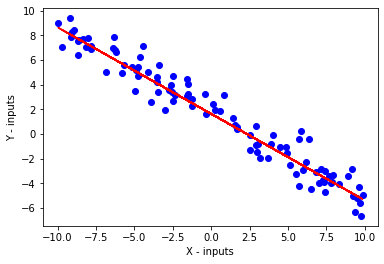

In [46]:
plt.scatter(X, y, color = 'blue')
plt.plot(X, hp_w*X+hp_b, 'r')
plt.xlabel("X - inputs")
plt.ylabel("Y - inputs")

# Step 8  Non-linear data and Non-linear model! 

# 8(a)

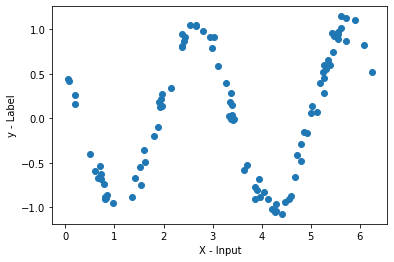

In [192]:
x, y = np.load("dataset_cos.npy")
plt.scatter(x, y)
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

8(b) -1

In [193]:
# ytrue= cos(2x+1)+noise
# ypred = wx+b   // linear regression, ignoring bias for now

In [194]:
#initializing w
w = np.random.uniform(-2, 2, 1)
n = len(x)
#ypred = w*x

In [195]:
#vectorized cost func
def vec_cost(W, X=x, Y=y):
    c = np.transpose(W*X - Y)@(W*X - Y)
    c = 1/(2*n)*c
    return c

In [196]:
# gradient descent on on non-linear dataset
def vec_gradient(W, X, Y):
    learning_rate = 0.05
    c = []
    final_weight = []
    for i in range(80):
        W = W - learning_rate*(1/n)*np.transpose(X)@(W*X - Y)
        c.append(vec_cost(W))
        final_weight.append(W)
    return c, final_weight

In [197]:
cost_in_iterations, weights_in_interation = vec_gradient(w, x, y)

Text(0.5, 1.0, 'Trend over Iterations')

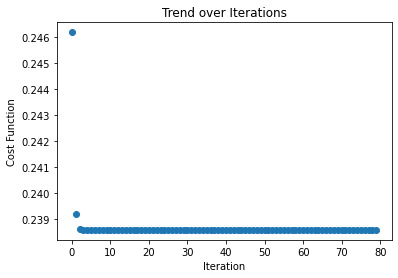

In [198]:
# change in cost wrt to iterations
plt.scatter(np.arange(0, 80), cost_in_iterations)
plt.xlabel('Iteration'); plt.ylabel('Cost Function'); plt.title('Trend over Iterations')

Text(0.5, 1.0, 'Trend over Iterations')

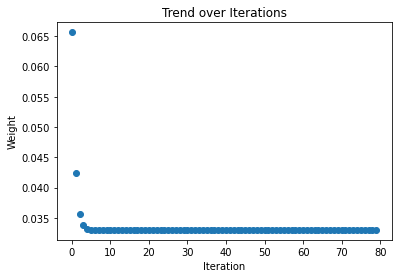

In [199]:
# change in weight wrt to iterations
plt.scatter(np.arange(0, 80), weights_in_interation)
plt.xlabel('Iteration'); plt.ylabel('Weight'); plt.title('Trend over Iterations')

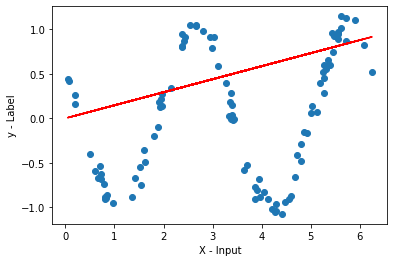

In [200]:
plt.scatter(x, y)
plt.plot(x, w*x, 'r')
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

8(b) - 1
The above graph simply shows that the linear model is not good fit for the given dataset. This behaviour can be observed for all the values of w throught the iterations which becomes constant after few iterations. The simple reason for this, after reaching at a certain value it is not moving much i.e reached global minima.

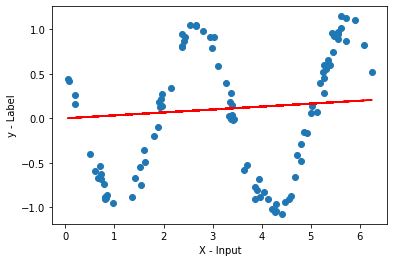

In [201]:
# graph for random w, in iteration
plt.scatter(x, y)
plt.plot(x, weights_in_interation[35]*x, 'r')
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

As we can simply observe, the weight is almost constant after few iterations this happens because it has reached its global minima and not moving 

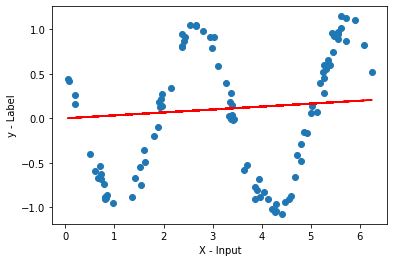

In [136]:
plt.scatter(x, y)
plt.plot(x, weights_in_interation[79]*x, 'r')
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

# 8(b) - 2

Calculating cost for the given values of x, when ypred = 0.

In [202]:
# preparing dataset for comparison (x values between 0 and 2pi)
new_x = np.random.uniform(0, 6.28, 100)
y_pred = np.zeros(100)

In [203]:
# ytrue= cos(2x+1)
y_true = []
for x in new_x:
    y_true.append(np.cos(2*x+1))

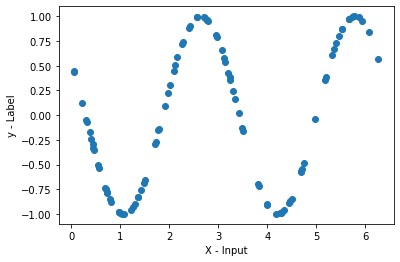

In [204]:
plt.scatter(new_x, y_true)
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

with ypred=0

In [205]:
# cost when ypred=0 on on non-linear dataset
vec_cost(0, X=0, Y=np.array(y_true))

0.26180104087684974

In [206]:
new_cost = 0.26180104087684974

Observation of cost from the above operation

In [207]:
new_cost, cost_in_iterations[79]

(0.26180104087684974, 0.23858340580662973)

The cost for (ypred = 0) is almost similar to the one I got from gradient descent (0.26180104087684974, 0.23858340580662973)

# 8 (c)

In [208]:
#ypred= cos(w*x+b)

Updated parameters in gradient descent  -- Derivative

$$ d(f)/d(w) = 1/n\sum_{i=1}^n(yi - cos(mxi + b) * sin(mxi + b) * xi) $$

$$ d(f)/d(b) = 1/n\sum_{i=1}^n(yi - cos(mxi + b) * sin(mxi + b) ) $$

In [209]:
#ytrue= cos(2x+1)

In [210]:
x, y = np.load("dataset_cos.npy")

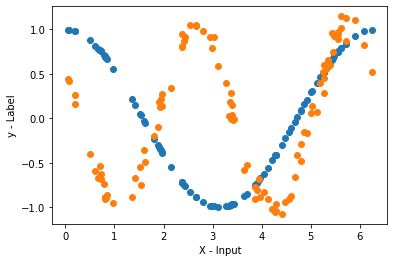

In [211]:
# graph of cos(x) with ytrue
y_est = np.cos(x)
plt.scatter(x, y_est)
plt.scatter(x, y)
plt.xlabel("X - Input")
plt.ylabel("y - Label")
plt.show()

Estimate the value of w and b in the equation y_true = cos(wx+b)+noise, ignoring noise for now

In [212]:
# cos(x[0]), ytrue[0]
#y = cos(x)
# y = cos(wx+b)+ noise
np.cos(x[0]), y[0]

(0.6982185102582326, -0.8895175836771987)

For first data point i.e x[0], value of cos(x[0]) is 0.6982185102582326 however, when we see the value at y[0] which comes from the above (y_true) equation is -0.8895175836771987

To estimate the value of w and b, we can simply try random w and b values and apply cos(A+B)

trying with w = 1 and b =1

In [213]:
np.cos(x[0])*np.cos(1) - np.sin(x[0])*np.sin(1)

-0.22514713726755559

w = 2, b = 1

In [214]:
np.cos(2*x[0])*np.cos(1) - np.sin(2*x[0])*np.sin(1)

-0.8547061034118567

Using w=2 and b=1 gives us -0.8547061034118567 which is almost equal to y[0] i.e -0.8895175836771987

If we add noise, we will get the exact same value as y[0], so using this appraoch we can easily guestimate ideal w, b value

# 8 - (d)

In [260]:
def poly_gradientDescent_dw(W, b, X, Y):
    y_pred = np.cos(np.dot(W, X) + b)
    d_w = (1/n) * sum( (y - y_pred) * np.sin(W*X+b) * X )
    return d_w

In [261]:
def poly_gradientDescent_db(W, b, X, Y):
    y_pred = np.cos(np.dot(W, X) + b)
    d_b = (1/n) * sum( (Y - y_pred) * np.sin(W*X+b) )
    return d_b

In [262]:
def cost_function(X,Y,W, b):
    y_pred = np.cos(np.dot(X,W)+b)
    cost = (1/n) * np.sum((Y - y_pred) ** 2)
    return cost

In [263]:
def solution(epoch, learning_rate, W, b, X, Y):
    w_set = []
    b_set = []
    c = []
    for i in range(epoch):
        W = W - learning_rate * poly_gradientDescent_dw(W, b, X, Y)
        b = b - learning_rate * poly_gradientDescent_db(W, b, X, Y)
        w_set.append(W)
        b_set.append(b)
        c.append(cost_function(X, Y, W, b))
    return w_set, b_set, c

In [264]:
winitial=0.1
binitial=0.0
w_out, b_out, c_out = solution(1000, 0.05, winitial, binitial, x, y)

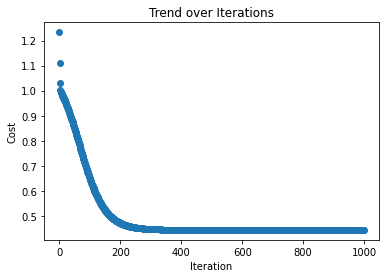

In [265]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('Cost'); plt.title('Trend over Iterations')
plt.show()

In [266]:
c_out[-1]

0.44461188651865235

In [267]:
winitial=0.5
binitial=0.0
w_out, b_out, c_out = solution(1000, 0.05, winitial, binitial, x, y)

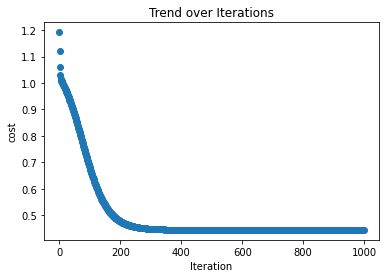

In [268]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [269]:
c_out[-1]

0.44461188701725773

In [270]:
winitial=1.5
binitial=0.0
w_out, b_out, c_out = solution(1000, 0.05, winitial, binitial, x, y)

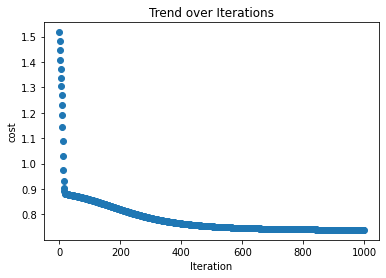

In [271]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [272]:
c_out[-1]

0.7392987457383754

In [273]:
winitial=1.9
binitial=0.0
w_out, b_out, c_out = solution(1000, 0.05, winitial, binitial, x, y)

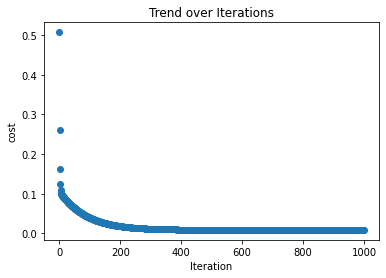

In [274]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [259]:
w_out

[1.999442414086057,
 2.0828705329147623,
 2.136195038843124,
 2.168061919673728,
 2.187423835462489,
 2.1993908862045717,
 2.2068011764797317,
 2.211310493064441,
 2.213931381226814,
 2.2153049470065054,
 2.215847026366532,
 2.2158317915835153,
 2.2154420103025534,
 2.2148004134260884,
 2.213989814525325,
 2.213066267145331,
 2.212067786273655,
 2.211020183344031,
 2.2099409946298203,
 2.208842137048406,
 2.2077317084791095,
 2.2066152102272714,
 2.2054963779380046,
 2.204377746667112,
 2.2032610352399593,
 2.2021474076858074,
 2.201037651031292,
 2.1999322961801626,
 2.1988317000708326,
 2.1977361014950785,
 2.196645659006829,
 2.195560476657118,
 2.194480621457559,
 2.1934061352261986,
 2.192337042619855,
 2.191273356578819,
 2.1902150820165467,
 2.1891622183195936,
 2.1881147610413723,
 2.1870727030498784,
 2.186036035305764,
 2.185004747390268,
 2.1839788278639447,
 2.182958264510993,
 2.1819430445062595,
 2.1809331545300026,
 2.179928580847359,
 2.178929309363981,
 2.1779353256655

In [276]:
c_out[-1]

0.008668150380970446

In all the initializations, the value of ypred is getting close to ytrue so the overall cost is decreasing. In the gradient descent we are calculating the updated cost using the given true and pred values of the parameters. When we increased the value of w_initial the predicted values were getting almost close to the true value i.e 2 for w and 1 for b. As the learning rate is high we can easily observe the cost increasing first and then decreasing, this is because the loss function (MSE) is convex and is diverging. Although the it is converging with all the initializations, better convergence is observed with w_initial=1.9 that is close to w_true.

# 8 - (e)

In [292]:
#mt+1,w = μ mt,w+ dL/dw
#wt+1 = wt-⍺ mt+1,w

In [293]:
def poly_gradientDescent_dw(W, b, X, Y):
    m = 0
    y_pred = np.cos(np.dot(W, X) + b)
    m = 0.99*m +  (1/n) * sum( (y - y_pred) * np.sin(W*X+b) * X )
    return m

In [294]:
def poly_gradientDescent_db(W, b, X, Y):
    m = 0
    y_pred = np.cos(np.dot(W, X) + b)
    m = 0.99*m + (1/n) * sum( (Y - y_pred) * np.sin(W*X+b) )
    return m

In [295]:
def optimal(epoch, learning_rate, W, b, X, Y):
    w_set = []
    b_set = []
    c = []
    for i in range(epoch):
        W = W - learning_rate * poly_gradientDescent_dw(W, b, X, Y)
        b = b - learning_rate * poly_gradientDescent_db(W, b, X, Y)
        w_set.append(W)
        b_set.append(b)
        c.append(cost_function(X, Y, W, b))
    return w_set, b_set, c

In [296]:
winitial=0.1
binitial=0.0
w_out, b_out, c_out = optimal(1000, 0.05, winitial, binitial, x, y)

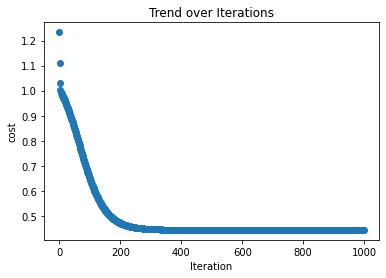

In [297]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [298]:
c_out[-1]

0.44461188651865235

In [299]:
winitial=0.5
binitial=0.0
w_out, b_out, c_out = optimal(1000, 0.005, winitial, binitial, x, y)

In [300]:
c_out[-1]

0.6931550647516573

In [301]:
winitial=1.5
binitial=0.0
w_out, b_out, c_out = optimal(1000, 0.005, winitial, binitial, x, y)

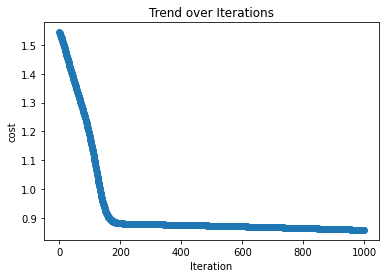

In [302]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [303]:
c_out[-1]

0.859125864588673

In [304]:
winitial=1.9
binitial=0.0
w_out, b_out, c_out = optimal(1000, 0.005, winitial, binitial, x, y)

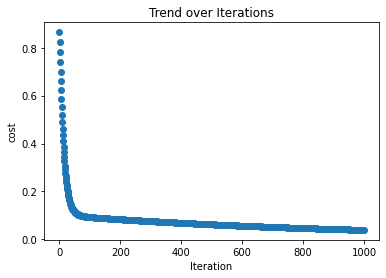

In [305]:
plt.scatter(np.arange(0, 1000), c_out)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [306]:
w_out

[1.9099442414086056,
 1.9198732462403996,
 1.9297512117064324,
 1.9395437425663664,
 1.9492185180568755,
 1.9587458488767553,
 1.9680991036388829,
 1.9772549955143706,
 1.9861937306198956,
 1.9948990288389967,
 2.003358034469369,
 2.0115611380812384,
 2.0195017324063453,
 2.027175924394573,
 2.0345822233643562,
 2.0417212220413274,
 2.0485952837632224,
 2.0552082456434406,
 2.061565144312564,
 2.0676719681557882,
 2.073535437795724,
 2.0791628149258483,
 2.0845617384283606,
 2.089740085937786,
 2.0947058585586253,
 2.0994670862353537,
 2.1040317512391185,
 2.108407727321835,
 2.1126027322510943,
 2.1166242916450533,
 2.1204797122511185,
 2.124176063039022,
 2.1277201626968227,
 2.1311185723208115,
 2.1343775922736876,
 2.137503262348415,
 2.1405013645178674,
 2.1433774276738227,
 2.14613673386455,
 2.148784325629933,
 2.151325014108678,
 2.1537633876554305,
 2.1561038207583,
 2.1583504830909135,
 2.1605073485690354,
 2.162578204311245,
 2.164566659427193,
 2.166476153576461,
 2.1683099

In [307]:
c_out[-1]

0.03903436815201867

The cost for all the initializations in case of gradient descent with momentum is converging and is close to the true values of w and b. The 0.99 momentum value in actually helping in average over the gradient descent with interns affect the parameters in the network. This is similar to the part (d) where the cost was converging when the predicted values were getting close to true values. Although the convergence was better in without momentum because the weights and bias were more close to the true values.

# 8 - (f)

In [344]:
n = len(y)
def stochastic_gradient(epoch, learning_rate, W, b, X, Y):
    new_cost = []
    for i in range(epoch):
        for j in range(len(x)):
            dw = (1/n) * ( Y[j] -  np.cos(np.dot(W, X[j]) + b)) * np.sin(W*X[j]+b) * X[j]
            db = (1/n) * ( Y[j] -  np.cos(np.dot(W, X[j]) + b)) * np.sin(W*X[j]+b)
            W = W - learning_rate * dw
            b = b - learning_rate * db
            new_cost.append(cost_function(X[j],Y[j],W, b))
    return W, b, new_cost

In [309]:
winitial=0.1
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.05, winitial, binitial, x, y)

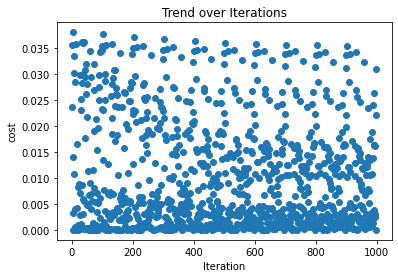

In [310]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [311]:
sto_cost[-1]

0.022116583525853613

In [312]:
winitial=0.5
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.05, winitial, binitial, x, y)

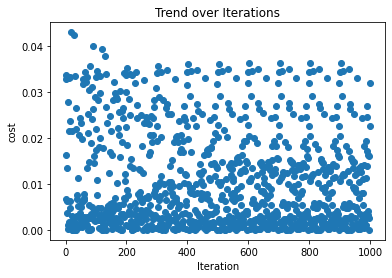

In [313]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [314]:
winitial=1.5
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.05, winitial, binitial, x, y)

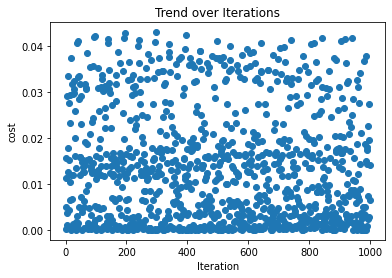

In [315]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [345]:
winitial=1.9
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.05, winitial, binitial, x, y)

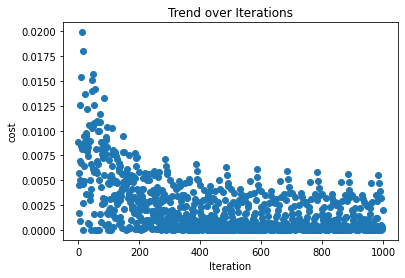

In [346]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [347]:
sto_cost[-1]

0.0019594932748915788

In [348]:
sto_w

2.205825475862986

A significant change is being observed in the convergence for all the initializations because the updation of parameters is happening for a single data point. Even the weight is little high in the final epoch, we are converging better. 

# 8 - (g)

In [324]:
#with momemtum and learning rate 0.05

In [339]:
n = len(y)
def stochastic_gradient(epoch, learning_rate, W, b, X, Y):
    new_cost = []
    m = 0
    for i in range(epoch):
        for j in range(len(x)):
            dw = 0.99*m + (1/n) * ( Y[j] -  np.cos(np.dot(W, X[j]) + b)) * np.sin(W*X[j]+b) * X[j]
            db = 0.99*m + (1/n) * ( Y[j] -  np.cos(np.dot(W, X[j]) + b)) * np.sin(W*X[j]+b)
            W = W - learning_rate * dw
            b = b - learning_rate * db
            new_cost.append(cost_function(X[j],Y[j],W, b))
    return W, b, new_cost

In [340]:
winitial=1.9
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.05, winitial, binitial, x, y)

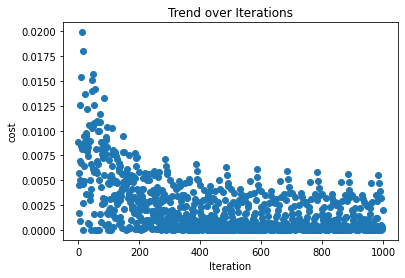

In [341]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [342]:
sto_cost[-1]

0.0019594932748915788

In [343]:
sto_w

2.205825475862986

No difference with learning rate 0.05

In [349]:
# with learning rate 0.0005
winitial=1.9
binitial=0.0
sto_w, sto_b, sto_cost = stochastic_gradient(10, 0.0005, winitial, binitial, x, y)

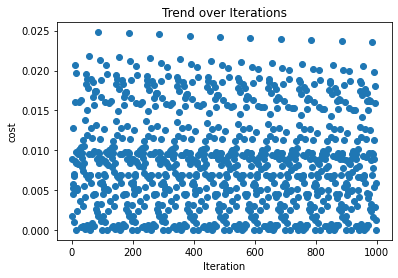

In [350]:
plt.scatter(np.arange(0, 1000), sto_cost)
plt.xlabel('Iteration'); plt.ylabel('cost'); plt.title('Trend over Iterations')
plt.show()

In [351]:
sto_cost[-1], sto_w

(0.005881462092046996, 1.9099396505177768)

We can clearly observe the difference in convergence when we changed learning rate, the pred parameters became more refined and when we reached to the global minima little slower.

In [353]:
sto_cost 

[0.008916780580920493,
 0.0017482455196516451,
 0.0057071687632148475,
 0.004564618098494914,
 0.01273382632855987,
 0.00520618911355405,
 0.006964968077847592,
 0.0010275244003969534,
 0.006788722457566493,
 0.0086862999005498,
 0.01609939430194591,
 0.020740269263419694,
 0.008397139445536253,
 0.009837212533542763,
 0.01965334291999282,
 1.0379664480091146e-05,
 0.005215871631515475,
 0.002398984336969093,
 0.005052781936996747,
 0.008229708597036915,
 0.009512641210468787,
 0.00983555637216697,
 0.016007304486622603,
 0.010055451035132827,
 0.010055085640543861,
 0.003616359796619214,
 0.009975910377226338,
 0.009923108337083554,
 0.010134843598701315,
 0.016345251074652522,
 0.010427890483536427,
 0.0003978867440734922,
 0.00903654225845678,
 0.00796049368483925,
 0.009633908581718437,
 0.0005190895510918677,
 0.011223375151520788,
 0.0030144868210211567,
 0.007350494203397818,
 0.010484250487573048,
 0.005543890820570452,
 0.008462264933160463,
 0.004112629374508692,
 9.703218987

# 8 - (h)

In case of (e) were added the factor of momentum in the updation of parameters, The 0.99 momentum value in actually helped in average over the gradient descent with interns affect the parameters in the network. The pred values were nearly close to true value which intern reduced the cost. It further imporved when we used stochastic gradient descent in (f), where we are updating parameter based on a single data point. (This method helped us to come out of local minima and reach the optimal value). In (g), we changed the learning rate, which further optimized the parameter update rules and minimed the risk of overshooting from our global minima